<a href="https://colab.research.google.com/github/Dasevil/Fundamentals-of-system-programming/blob/main/Photoshop_Recognition.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import torch
import torch.nn as nn
import torchvision.models as models
import torch.nn.functional as F
from torch.utils.data import DataLoader, Dataset
import torch.optim as optim
from torchvision import transforms
from PIL import Image
import cv2
import numpy as np
from google.colab.patches import cv2_imshow
import os

## блесс рнг реснет заработает ХОТЯ БЫ 18 БЛЯТЬ 50 Я В РОТ ЕБАЛ (извиняюсь, очко горит уже)

In [ ]:
class ManipulationDetectionModel(nn.Module):
    def __init__(self):
        super(ManipulationDetectionModel, self).__init__()
        resnet = models.resnet18(pretrained=True)
        self.feature_extractor = nn.Sequential(*list(resnet.children())[:-2])
        self.classifier = nn.Linear(resnet.fc.in_features, 2)
        self.unet_decoder = nn.Sequential(
            nn.ConvTranspose2d(512, 256, kernel_size=2, stride=2),
            nn.ReLU(inplace=True),
            nn.Conv2d(256, 128, kernel_size=3, padding=1),
            nn.ReLU(inplace=True),
            nn.ConvTranspose2d(128, 64, kernel_size=2, stride=2),
            nn.ReLU(inplace=True),
            nn.Conv2d(64, 1, kernel_size=3, padding=1),
            nn.Sigmoid()
        )

    def forward(self, x):
        features = self.feature_extractor(x)
        pooled_features = F.adaptive_avg_pool2d(features, (1, 1)).view(features.size(0), -1)
        classification_output = self.classifier(pooled_features)
        segmentation_output = self.unet_decoder(features)
        return classification_output, segmentation_output

## хотели градкам пусть хавают :D   

In [ ]:
def grad_cam(model, img, target_layer):
    img = img.unsqueeze(0)
    features = None
    grads = None

    def save_features_hook(module, input, output):
        nonlocal features
        features = output

    def save_grads_hook(module, grad_in, grad_out):
        nonlocal grads
        grads = grad_out[0]

    handle_feat = target_layer.register_forward_hook(save_features_hook)
    handle_grad = target_layer.register_backward_hook(save_grads_hook)

    model.eval()
    output, _ = model(img)
    pred = output.argmax(dim=1)
    model.zero_grad()
    output[0, pred].backward()

    handle_feat.remove()
    handle_grad.remove()

    weights = grads.mean(dim=(2, 3), keepdim=True)
    cam = (weights * features).sum(dim=1, keepdim=True)
    cam = F.relu(cam)
    cam = F.interpolate(cam, size=(img.shape[2], img.shape[3]), mode='bilinear', align_corners=False)
    cam = cam.squeeze().detach().numpy()
    cam = (cam - cam.min()) / (cam.max() - cam.min())
    return cam

## без препроцессинга нинада, а то хуева буит, чесна, я проверял

In [ ]:
def preprocess_image(image_path):
    image = Image.open(image_path).convert('RGB')
    transform = transforms.Compose([
        transforms.Resize((224, 224)),
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
    ])
    return transform(image)

## теперь полная жопа

In [ ]:
def detect_and_visualize(image_path):
    model = ManipulationDetectionModel()
    img = preprocess_image(image_path)
    with torch.no_grad():
        class_output, heatmap_output = model(img.unsqueeze(0))
        label = 'Редактировано' if class_output.argmax().item() == 1 else 'Оригинал'
    cam = grad_cam(model, img, model.feature_extractor[-1])

    image = cv2.imread(image_path)
    heatmap = cv2.applyColorMap(np.uint8(255 * cam), cv2.COLORMAP_JET)
    heatmap = cv2.resize(heatmap, (image.shape[1], image.shape[0]))
    if heatmap.shape[2] == 1:
        heatmap = cv2.cvtColor(heatmap, cv2.COLOR_GRAY2BGR)
    overlay = cv2.addWeighted(image, 0.5, heatmap, 0.5, 0)
    cv2_imshow(overlay)
    print(f'\n{label}\n')

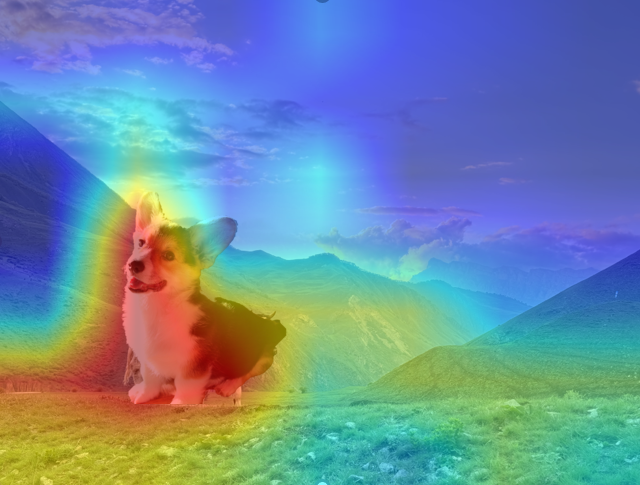


Редактировано



In [ ]:
detect_and_visualize('/content/red.png')

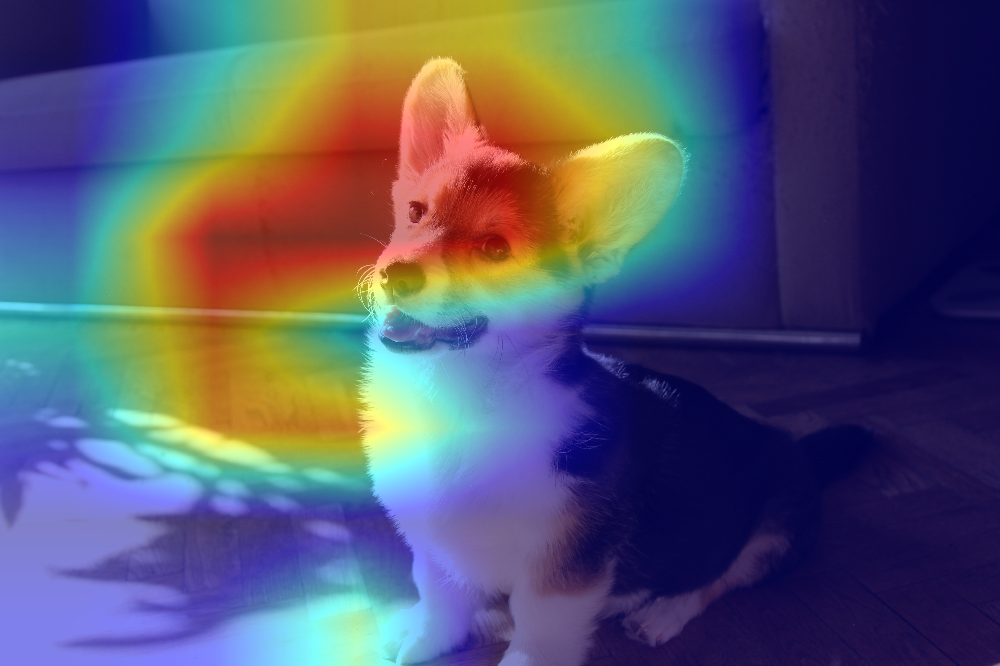


Оригинал



In [ ]:
detect_and_visualize('/content/IMG_9514.JPG')

In [ ]:
detect_and_visualize('/content/IMG_0383.jpeg')

## видимо теперь обучение а то она бездарь пока (и ее создатель тоже, учитывая сколько я с ней ебусь)

## сча намутим трейн и тест

In [ ]:
class ManipulationDataset(Dataset):
    def __init__(self, image_dir, transform=None):
        self.image_dir = image_dir
        self.transform = transform
        self.image_paths = []
        self.labels = []

        for label, folder_name in enumerate(['original', 'forged']):
            folder_path = os.path.join(image_dir, folder_name)
            if not os.path.isdir(folder_path):
                raise ValueError(f"Папка {folder_path} не существует.")
            for image_file in os.listdir(folder_path):
                if image_file.endswith((".jpg", ".png", ".jpeg")):
                    image_path = os.path.join(folder_path, image_file)
                    self.image_paths.append(image_path)
                    self.labels.append(label)

    def __len__(self):
        return len(self.image_paths)

    def __getitem__(self, idx):
        image_path = self.image_paths[idx]
        label = self.labels[idx]
        image = Image.open(image_path).convert("RGB")
        if self.transform:
            image = self.transform(image)
        return image, label


transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
])

train_dataset = ManipulationDataset(image_dir='/content/train', transform=transform)
train_loader = DataLoader(train_dataset, batch_size=32, shuffle=True)

test_dataset = ManipulationDataset(image_dir='/content/test', transform=transform)
test_loader = DataLoader(test_dataset, batch_size=32, shuffle=False)

ValueError: Папка /content/train/original не существует.

## представим что намутили Т&Т пора мутить лосс и классифаер

In [ ]:
model = ManipulationDetectionModel()
classification_loss_fn = nn.CrossEntropyLoss()
segmentation_loss_fn = nn.BCEWithLogitsLoss() #почитать, что делает
optimizer = optim.Adam(model.parameters(), lr=1e-4)
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
model = model.to(device)

## ох епта масло... 4 утра, нахуя я вот этим занимаюсь... мог бы щас в хогвартсе зельеварение ебашить а нет, сидеть учить пиксели какие-то другие пиксели искать... меня б кто научил...

In [ ]:
# @title Текст заголовка по умолчанию
num_epochs = 50
for epoch in range(num_epochs):
    model.train()
    running_loss = 0.0
    correct = 0
    total = 0
    for images, labels in train_loader:
        images, labels = images.to(device), labels.to(device)
        optimizer.zero_grad()
        class_outputs, seg_outputs = model(images)
        labels_seg = labels.view(-1, 1, 1).expand(-1, seg_outputs.shape[2], seg_outputs.shape[3])
        class_loss = classification_loss_fn(class_outputs, labels)
        seg_loss = segmentation_loss_fn(seg_outputs.squeeze(1), labels_seg.float())
        loss = class_loss + seg_loss
        loss.backward()
        optimizer.step()
        running_loss += loss.item()
        _, predicted = torch.max(class_outputs, 1)
        correct += (predicted == labels).sum().item()
        total += labels.size(0)

    print(f'Epoch [{epoch+1}/{num_epochs}], Loss: {running_loss/len(train_loader):.4f}, Accuracy: {100 * correct / total:.2f}%')

    model.eval()
    correct, total = 0, 0
    with torch.no_grad():
        for images, labels in test_loader:
            images, labels = images.to(device), labels.to(device)
            class_outputs, seg_outputs = model(images)
            _, predicted = torch.max(class_outputs, 1)
            correct += (predicted == labels).sum().item()
            total += labels.size(0)
    print(f'Test Accuracy: {100 * correct / total:.2f}%')

Epoch [1/50], Loss: 1.5240, Accuracy: 40.91%
Test Accuracy: 70.00%
Epoch [2/50], Loss: 1.0133, Accuracy: 93.18%
Test Accuracy: 80.00%
Epoch [3/50], Loss: 0.8850, Accuracy: 96.59%
Test Accuracy: 85.00%
Epoch [4/50], Loss: 0.8221, Accuracy: 98.86%
Test Accuracy: 85.00%
Epoch [5/50], Loss: 0.7948, Accuracy: 100.00%
Test Accuracy: 85.00%
Epoch [6/50], Loss: 0.7650, Accuracy: 98.86%
Test Accuracy: 75.00%
Epoch [7/50], Loss: 0.7416, Accuracy: 98.86%
Test Accuracy: 75.00%
Epoch [8/50], Loss: 0.7104, Accuracy: 100.00%
Test Accuracy: 75.00%
Epoch [9/50], Loss: 0.6963, Accuracy: 100.00%
Test Accuracy: 75.00%
Epoch [10/50], Loss: 0.6947, Accuracy: 98.86%
Test Accuracy: 75.00%
Epoch [11/50], Loss: 0.6810, Accuracy: 98.86%
Test Accuracy: 75.00%
Epoch [12/50], Loss: 0.6479, Accuracy: 100.00%
Test Accuracy: 75.00%
Epoch [13/50], Loss: 0.6384, Accuracy: 100.00%
Test Accuracy: 75.00%
Epoch [14/50], Loss: 0.6251, Accuracy: 100.00%
Test Accuracy: 75.00%
Epoch [15/50], Loss: 0.6347, Accuracy: 100.00%
Test

In [ ]:
# @title Текст заголовка по умолчанию
num_epochs = 50
for epoch in range(num_epochs):
    model.train()
    running_loss = 0.0
    correct = 0
    total = 0
    for images, labels in train_loader:
        images, labels = images.to(device), labels.to(device)
        optimizer.zero_grad()
        class_outputs, seg_outputs = model(images)
        labels_seg = labels.view(-1, 1, 1).expand(-1, seg_outputs.shape[2], seg_outputs.shape[3])
        class_loss = classification_loss_fn(class_outputs, labels)
        seg_loss = segmentation_loss_fn(seg_outputs.squeeze(1), labels_seg.float())
        loss = class_loss + seg_loss
        loss.backward()
        optimizer.step()
        running_loss += loss.item()
        _, predicted = torch.max(class_outputs, 1)
        correct += (predicted == labels).sum().item()
        total += labels.size(0)

    print(f'Epoch [{epoch+1}/{num_epochs}], Loss: {running_loss/len(train_loader):.4f}, Accuracy: {100 * correct / total:.2f}%')

    model.eval()
    correct, total = 0, 0
    with torch.no_grad():
        for images, labels in test_loader:
            images, labels = images.to(device), labels.to(device)
            class_outputs, seg_outputs = model(images)
            _, predicted = torch.max(class_outputs, 1)
            correct += (predicted == labels).sum().item()
            total += labels.size(0)
    print(f'Test Accuracy: {100 * correct / total:.2f}%')

NameError: name 'train_loader' is not defined

## сделаем вид что сохраняем веса (искренне надеюсь что я не зря все это делаю, и какая-нибудь ася потом не скажет а нах ты чет делала если это делать нинада мы сами давно все сделали и вообще кто такая эта ваша итмА)

In [ ]:
torch.save(model.state_dict(), 'model.pth')